In [1]:
!pip install opendatasets

In [2]:
import pandas as pd
import re
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
import opendatasets as od

In [3]:
od.download('https://www.kaggle.com/datasets/vishakhdapat/imdb-movie-reviews')

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: ashoksaigece
Your Kaggle Key: ··········
Dataset URL: https://www.kaggle.com/datasets/vishakhdapat/imdb-movie-reviews


100%|██████████| 25.7M/25.7M [00:03<00:00, 8.00MB/s]


In [4]:
!ls /content/imdb-movie-reviews

'IMDB Dataset.csv'


In [5]:
data = pd.read_csv("/content/imdb-movie-reviews/IMDB Dataset.csv")

In [6]:
data.head()

,review,sentiment
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production. <br /><br />The...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically there's a family where a little boy ...,negative
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive


In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   review     50000 non-null  object
 1   sentiment  50000 non-null  object
dtypes: object(2)
memory usage: 781.4+ KB


In [8]:
data.isnull().sum()

,0
review,0
sentiment,0


In [9]:
import nltk
nltk.download('stopwords')
stops = stopwords.words('english')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [11]:
df = pd.DataFrame(data)
def tokens(words):
  words = re.sub("[^a-zA-Z]"," ", words)
  text = words.lower().split()
  portstem = PorterStemmer()
  text = [portstem.stem(word) for word in text if not word in stops]
  return " ".join(text)
df['review'] = df['review'].apply(tokens)
df.head()

,review,sentiment
0,one review mention watch oz episod hook right ...,positive
1,wonder littl product br br film techniqu unass...,positive
2,thought wonder way spend time hot summer weeke...,positive
3,basic famili littl boy jake think zombi closet...,negative
4,petter mattei love time money visual stun film...,positive


In [ ]:
corpus=[]
for i in range(0,22628):
    Review=re.sub("[^a-zA-Z]"," ", df["review"][i])
    Review=Review.lower()
    Review=Review.split()
    ps=PorterStemmer()
    Review=[ps.stem(word) for word in Review if not word in set(stops)]
    tocken=" ".join(Review)
    corpus.append(tocken)

In [12]:
df.head()

,review,sentiment
0,one review mention watch oz episod hook right ...,positive
1,wonder littl product br br film techniqu unass...,positive
2,thought wonder way spend time hot summer weeke...,positive
3,basic famili littl boy jake think zombi closet...,negative
4,petter mattei love time money visual stun film...,positive


In [13]:
positive_words =[]
positive = df[df['sentiment']=='positive']
for i in positive.review:
    positive_words.append(i)
positive_words = ' '.join(positive_words)
positive_words

'one review mention watch oz episod hook right exactli happen br br first thing struck oz brutal unflinch scene violenc set right word go trust show faint heart timid show pull punch regard drug sex violenc hardcor classic use word br br call oz nicknam given oswald maximum secur state penitentari focus mainli emerald citi experiment section prison cell glass front face inward privaci high agenda em citi home mani aryan muslim gangsta latino christian italian irish scuffl death stare dodgi deal shadi agreement never far away br br would say main appeal show due fact goe show dare forget pretti pictur paint mainstream audienc forget charm forget romanc oz mess around first episod ever saw struck nasti surreal say readi watch develop tast oz got accustom high level graphic violenc violenc injustic crook guard sold nickel inmat kill order get away well manner middl class inmat turn prison bitch due lack street skill prison experi watch oz may becom comfort uncomfort view that get touch da

In [14]:
negative_words =[]
negative = df[df['sentiment']=='positive']
for i in negative.review:
    negative_words.append(i)
positive_words = ' '.join(negative_words)
positive_words

'one review mention watch oz episod hook right exactli happen br br first thing struck oz brutal unflinch scene violenc set right word go trust show faint heart timid show pull punch regard drug sex violenc hardcor classic use word br br call oz nicknam given oswald maximum secur state penitentari focus mainli emerald citi experiment section prison cell glass front face inward privaci high agenda em citi home mani aryan muslim gangsta latino christian italian irish scuffl death stare dodgi deal shadi agreement never far away br br would say main appeal show due fact goe show dare forget pretti pictur paint mainstream audienc forget charm forget romanc oz mess around first episod ever saw struck nasti surreal say readi watch develop tast oz got accustom high level graphic violenc violenc injustic crook guard sold nickel inmat kill order get away well manner middl class inmat turn prison bitch due lack street skill prison experi watch oz may becom comfort uncomfort view that get touch da

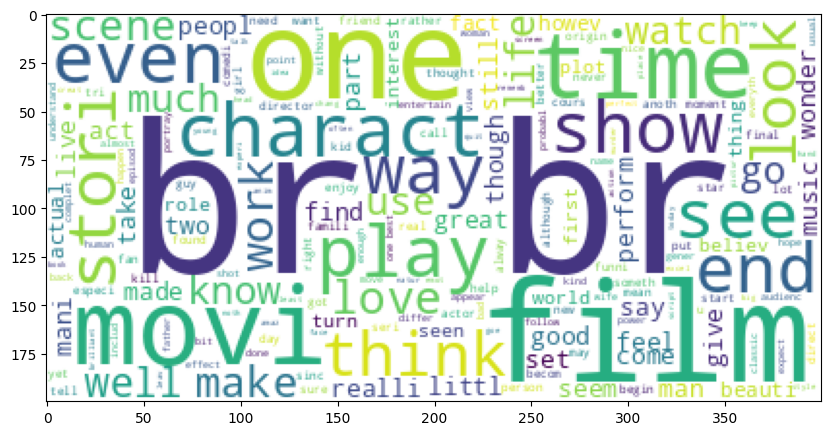

In [15]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
wordcloud = WordCloud(background_color='white').generate(positive_words)
plt.figure(figsize=(10,10))
plt.imshow(wordcloud)

In [38]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential
from keras.layers import Dense,Embedding,LSTM,Dropout,SimpleRNN,GRU
from keras.utils import to_categorical

In [27]:
tokenizer = Tokenizer(num_words = 2500)
tokenizer.fit_on_texts(df['review'])
sequences = tokenizer.texts_to_sequences(df['review'])

In [29]:
vocab = tokenizer.word_index
vocab

{'br': 1,
 'movi': 2,
 'film': 3,
 'one': 4,
 'like': 5,
 'time': 6,
 'good': 7,
 'make': 8,
 'charact': 9,
 'see': 10,
 'get': 11,
 'watch': 12,
 'even': 13,
 'stori': 14,
 'would': 15,
 'realli': 16,
 'well': 17,
 'scene': 18,
 'look': 19,
 'show': 20,
 'much': 21,
 'end': 22,
 'bad': 23,
 'great': 24,
 'peopl': 25,
 'go': 26,
 'love': 27,
 'also': 28,
 'first': 29,
 'think': 30,
 'act': 31,
 'play': 32,
 'way': 33,
 'thing': 34,
 'made': 35,
 'could': 36,
 'know': 37,
 'say': 38,
 'seem': 39,
 'work': 40,
 'plot': 41,
 'actor': 42,
 'two': 43,
 'mani': 44,
 'seen': 45,
 'come': 46,
 'year': 47,
 'want': 48,
 'take': 49,
 'never': 50,
 'life': 51,
 'best': 52,
 'tri': 53,
 'littl': 54,
 'ever': 55,
 'man': 56,
 'better': 57,
 'give': 58,
 'still': 59,
 'find': 60,
 'perform': 61,
 'feel': 62,
 'part': 63,
 'use': 64,
 'someth': 65,
 'director': 66,
 'actual': 67,
 'back': 68,
 'lot': 69,
 'interest': 70,
 'real': 71,
 'guy': 72,
 'old': 73,
 'funni': 74,
 'cast': 75,
 'though': 76,
 

In [60]:
max_length = 200
x = pad_sequences(sequences,maxlen=max_length)

In [79]:
y = df['sentiment']

In [80]:
from sklearn.model_selection import train_test_split
xtrain,xtest,ytrain,ytest = train_test_split(x,y,test_size=0.2,random_state=123)

In [81]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
ytrain = le.fit_transform(ytrain)
ytest = le.transform(ytest)
ytrain = to_categorical(ytrain)
ytest = to_categorical(ytest)

In [82]:
print(xtrain.shape)
print(xtest.shape)
print(ytrain.shape)
print(ytest.shape)

(40000, 200)
(10000, 200)
(40000, 2)
(10000, 2)


In [83]:
model = Sequential()
model.add(Embedding(input_dim=2500,output_dim=100,input_length=max_length))
model.add(SimpleRNN(64))
model.add(Dense(units=2,activation='sigmoid'))

/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


In [84]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [85]:
model.summary()

Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_6 (Embedding)              │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ simple_rnn_6 (SimpleRNN)             │ ?                           │     0 (unbuilt) │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ ?                           │     0 (unbuilt) │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

In [70]:
vocab_size = 2500  # Set a vocabulary size
embedding_dim = 100  # Embedding dimensions
max_length = 10  # Max sequence length

# Build the model
model = Sequential()
model.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=max_length))
model.add(SimpleRNN(64))  # SimpleRNN with 64 units
model.add(Dense(units=2, activation='sigmoid'))

In [86]:
model.fit(xtrain,ytrain,epochs=10,batch_size=128,validation_data=(xtest,ytest))

Epoch 1/10
313/313 ━━━━━━━━━━━━━━━━━━━━ 41s 124ms/step - accuracy: 0.6724 - loss: 0.5657 - val_accuracy: 0.8659 - val_loss: 0.3288
Epoch 2/10
313/313 ━━━━━━━━━━━━━━━━━━━━ 40s 121ms/step - accuracy: 0.8815 - loss: 0.2958 - val_accuracy: 0.8635 - val_loss: 0.3248
Epoch 3/10
313/313 ━━━━━━━━━━━━━━━━━━━━ 45s 132ms/step - accuracy: 0.8952 - loss: 0.2619 - val_accuracy: 0.8648 - val_loss: 0.3234
Epoch 4/10
313/313 ━━━━━━━━━━━━━━━━━━━━ 77s 116ms/step - accuracy: 0.9202 - loss: 0.2117 - val_accuracy: 0.8665 - val_loss: 0.3652
Epoch 5/10
313/313 ━━━━━━━━━━━━━━━━━━━━ 41s 115ms/step - accuracy: 0.9385 - loss: 0.1711 - val_accuracy: 0.8629 - val_loss: 0.3772
Epoch 6/10
313/313 ━━━━━━━━━━━━━━━━━━━━ 41s 114ms/step - accuracy: 0.9538 - loss: 0.1313 - val_accuracy: 0.8376 - val_loss: 0.4473
Epoch 7/10
313/313 ━━━━━━━━━━━━━━━━━━━━ 38s 121ms/step - accuracy: 0.9694 - loss: 0.0925 - val_accuracy: 0.8446 - val_loss: 0.5261
Epoch 8/10
313/313 ━━━━━━━━━━━━━━━━━━━━ 42s 124ms/step - accuracy: 0.9824 - loss: 0

In [90]:
pred = model.predict(xtest)

313/313 ━━━━━━━━━━━━━━━━━━━━ 10s 32ms/step


In [92]:
from sklearn.metrics import ConfusionMatrixDisplay,classification_report,confusion_matrix
import numpy as np

In [97]:
ytest = np.argmax(ytest,axis=1)
ypred = np.argmax(pred,axis=1)

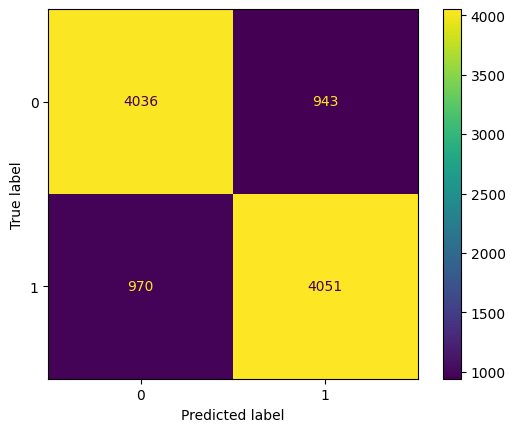

In [100]:
disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(ytest,ypred))
disp.plot()
plt.show()

In [101]:
print(classification_report(ytest,ypred))

              precision    recall  f1-score   support

           0       0.81      0.81      0.81      4979
           1       0.81      0.81      0.81      5021

    accuracy                           0.81     10000
   macro avg       0.81      0.81      0.81     10000
weighted avg       0.81      0.81      0.81     10000



In [104]:
!pip install gradio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.4/50.4 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.1/18.1 MB 57.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 318.7/318.7 kB 18.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.9/93.9 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.4/76.4 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 77.9/77.9 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 141.9/141.9 kB 10.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.3/10.3 MB 57.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.8/62.8 kB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.4/71.4 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/130.2 kB 6.2 MB/s eta 0:00:00
  Attempting uninstall: tomlkit
    Found existing i

In [105]:
import gradio as gr
def predict_sentiment(review):
  sequence = tokenizer.texts_to_sequences([review])
  padded_sequences = pad_sequences(sequence,max_len=max_length)
  prediction = model.predict(padded_sequences)
  sentiment = 'positive' if prediction[0][1] > 0.5 else 'negative'
  return sentiment

iface = gr.Interface(
    fn=predict_sentiment,
    inputs=gr.Textbox(lines=5, placeholder="Enter your review"),
    outputs="text",
    title="Sentiment Analysis App",
    description="Enter an review and get a prediction on whether it's positive or negative."
)

iface.launch()

Setting queue=True in a Colab notebook requires sharing enabled. Setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://c98b97086e37980870.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)
